# Student Name: Wallace Esteves
# Student ID : 2020326


# Task 1

In [1]:
import pandas as pd

# Load the dataset
file_path = 'Data/Marge_Bedfordshire.csv'
data = pd.read_csv(file_path)

# Display the first few rows of the dataset
data.head()

,Unnamed: 0,Crime ID,Month,Reported by,Falls within,Longitude,Latitude,Location,LSOA code,LSOA name,Crime type,Last outcome category,Context
0,0,f3b4eb5ff671847a8de4838f2deb31ad16825558ae1104...,2020-01,Bedfordshire Police,Bedfordshire Police,-0.678572,51.960550,On or near Park/Open Space,E01017669,Aylesbury Vale 006A,Criminal damage and arson,Status update unavailable,NaN
1,1,ea45d7028058f7611f0ea7885c5003b253c4adf54b1df2...,2020-01,Bedfordshire Police,Bedfordshire Police,-0.600189,51.873389,On or near Northall Road,E01017658,Aylesbury Vale 009D,Violence and sexual offences,Status update unavailable,NaN
2,2,4a9cf8bfd71238a0f5dfab36bc8d16e84afb7d1970879a...,2020-01,Bedfordshire Police,Bedfordshire Police,-0.600189,51.873389,On or near Northall Road,E01017658,Aylesbury Vale 009D,Violence and sexual offences,Status update unavailable,NaN
3,3,4e28320826593de789a97acea21d0658a0bae95fc6ebbb...,2020-01,Bedfordshire Police,Bedfordshire Police,-0.417743,52.237802,On or near Elm Tree Grove,E01017540,Bedford 001A,Criminal damage and arson,Investigation complete; no suspect identified,NaN
4,4,3456382b4426f30a4d1d8aae3f10b6b7614dbb566946f8...,2020-01,Bedfordshire Police,Bedfordshire Police,-0.411488,52.225940,On or near School Lane,E01017540,Bedford 001A,Other theft,Investigation complete; no suspect identified,NaN


# Task B: Identifying Variable Types and Missing Values

Explanation: We will categorize the variables into categorical, discrete, and continuous types based on their nature and the data they hold. We'll also check for missing values in each column.

In [2]:
# Identifying variable types and checking for missing values
variable_types = {
    "Categorical": [],
    "Discrete": [],
    "Continuous": []
}
missing_values = data.isnull().sum()

# Categorizing variables
for column in data.columns:
    if data[column].dtype == 'object':
        variable_types["Categorical"].append(column)
    elif data[column].dtype in ['int64', 'float64']:
        if data[column].nunique() < 10:
            variable_types["Discrete"].append(column)
        else:
            variable_types["Continuous"].append(column)

# Displaying the results
variable_types, missing_values


({'Categorical': ['Crime ID',
   'Month',
   'Reported by',
   'Falls within',
   'Location',
   'LSOA code',
   'LSOA name',
   'Crime type',
   'Last outcome category'],
  'Discrete': ['Context'],
  'Continuous': ['Unnamed: 0', 'Longitude', 'Latitude']},
 Unnamed: 0                    0
 Crime ID                  34876
 Month                         0
 Reported by                   0
 Falls within                  0
 Longitude                     0
 Latitude                      0
 Location                      0
 LSOA code                     0
 LSOA name                     0
 Crime type                    0
 Last outcome category     34876
 Context                  156767
 dtype: int64)

# Task C: Statistical Parameters Calculation
Explanation:
Now, we will calculate statistical parameters such as mean, median, minimum, maximum, and standard deviation for each of the numerical variables.

In [3]:
#Task C
# Calculating statistical parameters for continuous variables
statistical_params = data.describe().T[['mean', '50%', 'min', 'max', 'std']].rename(columns={'50%': 'median'})

# Displaying the results
statistical_params


,mean,median,min,max,std
Unnamed: 0,78383.000000,78383.000000,0.000000,156766.000000,45254.879162
Longitude,-0.455201,-0.457553,-5.540364,1.731959,0.104470
Latitude,51.990858,51.917292,50.119077,55.234600,0.127505
Context,NaN,NaN,NaN,NaN,NaN


# Task D

In [4]:
#Task D
from sklearn.preprocessing import MinMaxScaler, StandardScaler, RobustScaler

# Selecting numerical columns for scaling
numerical_cols = ['Longitude', 'Latitude']

# Applying Min-Max Normalization
min_max_scaler = MinMaxScaler()
data_min_max = min_max_scaler.fit_transform(data[numerical_cols])

# Applying Z-score Standardization
standard_scaler = StandardScaler()
data_standardized = standard_scaler.fit_transform(data[numerical_cols])

# Applying Robust Scaler
robust_scaler = RobustScaler()
data_robust = robust_scaler.fit_transform(data[numerical_cols])

# Converting the scaled data back to a DataFrame for visualization
scaled_data = {
    "Min-Max Scaled": data_min_max,
    "Z-score Scaled": data_standardized,
    "Robust Scaled": data_robust
}
scaled_data_df = {key: pd.DataFrame(value, columns=numerical_cols) for key, value in scaled_data.items()}

# Displaying the first few rows of the scaled data
scaled_data_df["Min-Max Scaled"].head(),scaled_data_df["Z-score Scaled"].head(),scaled_data_df["Robust Scaled"].head()


(   Longitude  Latitude
 0   0.668534  0.359977
 1   0.679312  0.342939
 2   0.679312  0.342939
 3   0.704400  0.414176
 4   0.705260  0.411857,
    Longitude  Latitude
 0  -2.138151 -0.237702
 1  -1.387853 -0.921291
 2  -1.387853 -0.921291
 3   0.358556  1.936738
 4   0.418430  1.843706,
    Longitude  Latitude
 0  -2.846862  0.183725
 1  -1.837240 -0.186464
 2  -1.837240 -0.186464
 3   0.512778  1.361266
 4   0.593346  1.310886)

In [ ]:
# Here I decided to create a plot to have a better visualization

import matplotlib.pyplot as plt

# Function to create scatter plots for scaled data
def create_scatter_plot(dataframe, title, ax):
    ax.scatter(dataframe['Longitude'], dataframe['Latitude'])
    ax.set_title(title)
    ax.set_xlabel('Scaled Longitude')
    ax.set_ylabel('Scaled Latitude')

# Creating subplots
fig, axes = plt.subplots(1, 3, figsize=(18, 6))

# Min-Max Scaled plot
create_scatter_plot(scaled_data_df["Min-Max Scaled"], 'Min-Max Scaled Data', axes[0])

# Z-score Scaled plot
create_scatter_plot(scaled_data_df["Z-score Scaled"], 'Z-score Scaled Data', axes[1])

# Robust Scaled plot
create_scatter_plot(scaled_data_df["Robust Scaled"], 'Robust Scaled Data', axes[2])

# Displaying the plots
plt.tight_layout()
plt.show()


This code will apply the three scaling techniques to the 'Longitude' and 'Latitude' columns and then convert the scaled data back into pandas DataFrames for ease of visualization. Let's execute it.

Results from Task D: Normalization and Standardization
The numerical data (Longitude and Latitude) has been scaled using three different techniques:

Min-Max Scaled Data:

Scaled such that the values fall within the range [0, 1].
Example values:
Longitude: [0.6685, 0.6793, 0.6793, 0.7044, 0.7053]
Latitude: [0.3600, 0.3429, 0.3429, 0.4142, 0.4119]
Z-score Scaled Data:

Standardized with a mean of 0 and a standard deviation of 1.
Example values:
Longitude: [-2.1382, -1.3879, -1.3879, 0.3586, 0.4184]
Latitude: [-0.2377, -0.9213, -0.9213, 1.9367, 1.8437]
Robust Scaled Data:

Scaled using the median and interquartile range, making it more robust to outliers.
Example values:
Longitude: [-2.8469, -1.8372, -1.8372, 0.5128, 0.5933]
Latitude: [0.1837, -0.1865, -0.1865, 1.3613, 1.3109]
These transformations are crucial for data analysis and modeling, as they standardize the range and distribution of the data, making it easier to compare and understand.

# Task E
Correlation Visualization
Explanation:
We'll create interactive visualizations to explore the correlation between features in the dataset. Specifically, we'll use line plots, scatter plots, and heatmaps. These visualizations will help us understand the relationships between different variables.

Code for Task E:
To create interactive visualizations, we can use libraries like Plotly or Bokeh. Here, I'll demonstrate using Plotly.

Line Plot:
We can create a line plot for the continuous variables over time (if a time variable like 'Month' is available).
Scatter Plot:
A scatter plot of continuous variables like 'Longitude' and 'Latitude' to observe any patterns.
Heatmap:
A heatmap of the correlation matrix to visualize the strength of relationships between numerical variables.

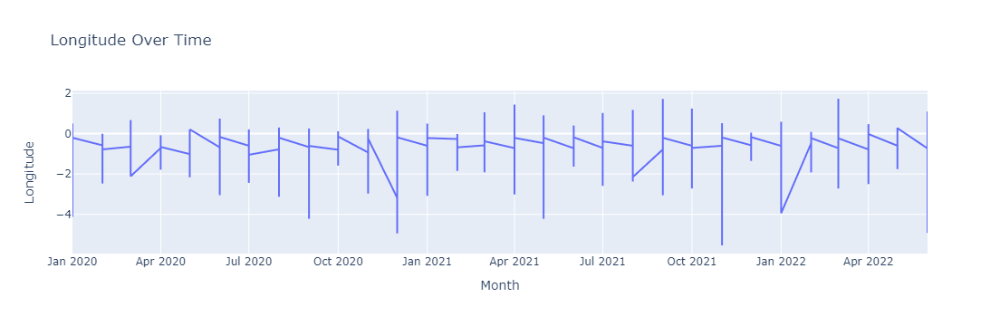

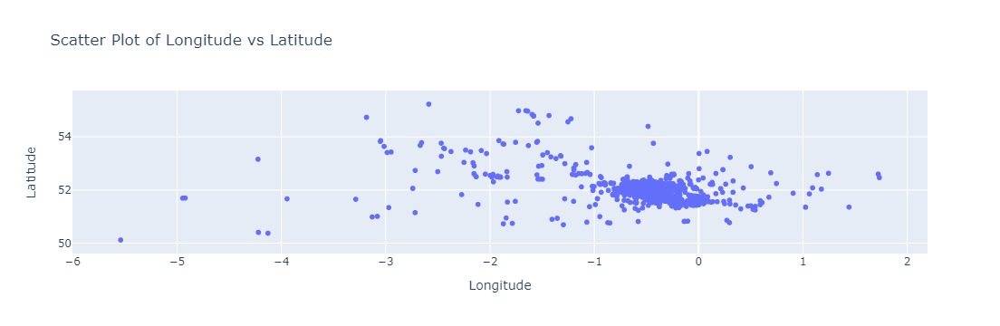

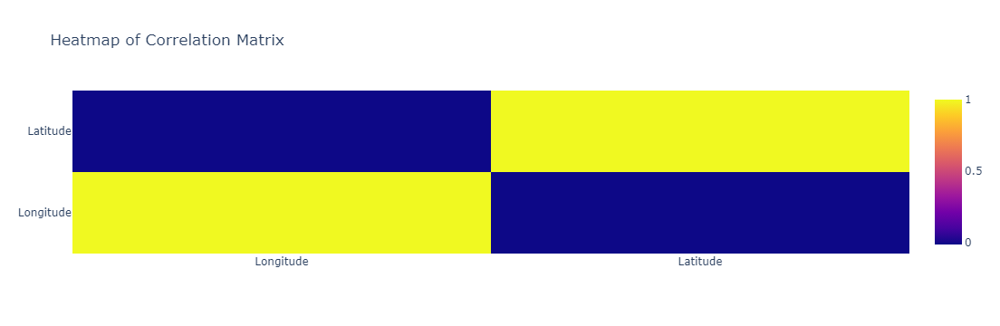

In [6]:
import plotly.express as px
import plotly.graph_objects as go

# Line Plot
# Assuming 'Month' is in YYYY-MM format and using 'Longitude' as an example variable
data['Month'] = pd.to_datetime(data['Month'])
line_fig = px.line(data, x='Month', y='Longitude', title='Longitude Over Time')

# Scatter Plot
scatter_fig = px.scatter(data, x='Longitude', y='Latitude', title='Scatter Plot of Longitude vs Latitude')

# Heatmap
corr_matrix = data[numerical_cols].corr()
heatmap_fig = go.Figure(data=go.Heatmap(
                    z=corr_matrix,
                    x=corr_matrix.columns,
                    y=corr_matrix.columns,
                    hoverongaps = False))
heatmap_fig.update_layout(title='Heatmap of Correlation Matrix')

# Displaying the figures
line_fig.show()
scatter_fig.show()
heatmap_fig.show()


# Task F

In [26]:
#Task F
# Applying dummy encoding to 'Crime type'
dummy_encoded_data = pd.get_dummies(data['Crime type'], prefix='Crime')

# Displaying the result
dummy_encoded_data.head()

,Crime_Anti-social behaviour,Crime_Bicycle theft,Crime_Burglary,Crime_Criminal damage and arson,Crime_Drugs,Crime_Other crime,Crime_Other theft,Crime_Possession of weapons,Crime_Public order,Crime_Robbery,Crime_Shoplifting,Crime_Theft from the person,Crime_Vehicle crime,Crime_Violence and sexual offences
0,False,False,False,True,False,False,False,False,False,False,False,False,False,False
1,False,False,False,False,False,False,False,False,False,False,False,False,False,True
2,False,False,False,False,False,False,False,False,False,False,False,False,False,True
3,False,False,False,True,False,False,False,False,False,False,False,False,False,False
4,False,False,False,False,False,False,True,False,False,False,False,False,False,False


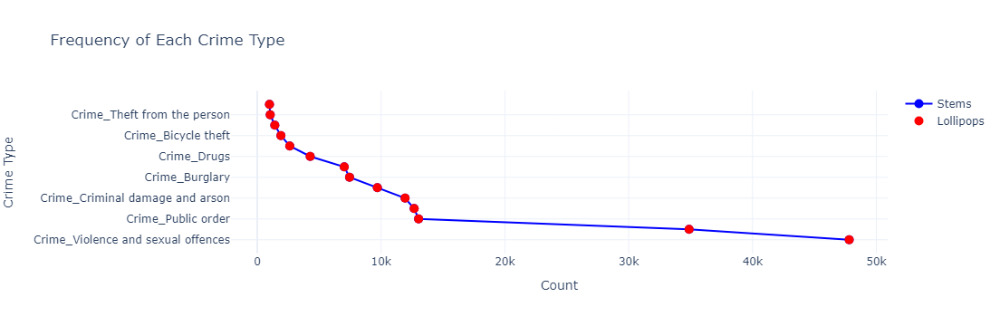

In [27]:
import plotly.graph_objects as go

# Summing up the dummy encoded values to get counts for each crime type
crime_type_counts = dummy_encoded_data.sum().sort_values(ascending=False)

# Creating a stem plot
fig = go.Figure()

# Adding the stems (lines)
fig.add_trace(go.Scatter(
    x=crime_type_counts.values,
    y=crime_type_counts.index,
    mode='lines+markers',
    name='Stems',
    line=dict(color='blue', width=2),
    marker=dict(color='blue', size=10)
))

# Adding the base (lollipops)
fig.add_trace(go.Scatter(
    x=crime_type_counts.values,
    y=crime_type_counts.index,
    mode='markers',
    name='Lollipops',
    marker=dict(color='red', size=10, symbol='circle')
))

# Setting the layout for the plot
fig.update_layout(
    title='Frequency of Each Crime Type',
    xaxis_title='Count',
    yaxis_title='Crime Type',
    template='plotly_white'
)

# Displaying the plot
fig.show()

#This code will create an interactive stem plot where each stem represents a crime type,
#and the length of the stem indicates the frequency of that crime type. The plot is interactive,
#so you can hover over points to see more details, zoom in/out, and pan around.


# Task G 

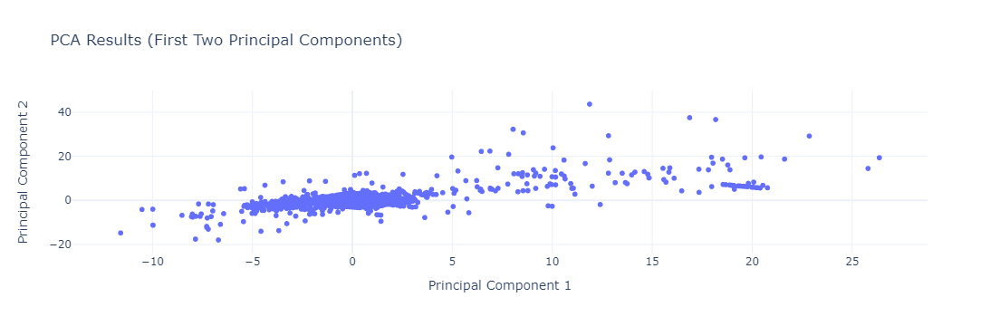

In [28]:
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
import plotly.express as px
import pandas as pd

# Load the dataset
file_path = 'Data/Marge_Bedfordshire.csv'  # Adjust the path as needed
data = pd.read_csv(file_path)

# Dropping the 'Context' column
data = data.drop(columns=['Context'], errors='ignore')

# Selecting only numerical columns for PCA
numerical_data = data.select_dtypes(include=['float64', 'int64'])

# Standardizing the data
scaler = StandardScaler()
standardized_data = scaler.fit_transform(numerical_data)

# Applying PCA
pca = PCA(n_components=2)  # Using 2 components for simplicity
pca_result = pca.fit_transform(standardized_data)

# Creating an interactive scatter plot of the PCA results
pca_df = pd.DataFrame(pca_result, columns=['PCA1', 'PCA2'])
fig = px.scatter(pca_df, x='PCA1', y='PCA2', title='PCA Results (First Two Principal Components)')
fig.update_layout(xaxis_title='Principal Component 1', yaxis_title='Principal Component 2', template='plotly_white')
fig.show()
